## Setup

In [ ]:
!pip install -q -U "tensorflow-text==2.8.*"

In [ ]:
!pip install -q tf-models-official==2.7.0

In [ ]:
!pip install tensorflow_addons

In [ ]:
!pip install -U --no-cache-dir gdown --pre

In [ ]:
!gdown --no-cookies --id 1f_BAk6dzyXW5MX4E8S0OMWV1k1mqef1X

In [ ]:
!unzip demake_up_data.zip

## Import Module/Library

In [1]:
import cv2
import os
import numpy as np
import matplotlib.pyplot as plt 

import tensorflow as tf
from tensorflow.keras import layers
from tensorflow.keras.models import Model
import tensorflow_addons as tfa

/home/aivn48/anaconda3/envs/tf/lib/python3.9/site-packages/tensorflow_addons/utils/ensure_tf_install.py:53: UserWarning: Tensorflow Addons supports using Python ops for all Tensorflow versions above or equal to 2.9.0 and strictly below 2.12.0 (nightly versions are not supported). 
 The versions of TensorFlow you are currently using is 2.8.4 and is not supported. 
Some things might work, some things might not.
If you were to encounter a bug, do not file an issue.
If you want to make sure you're using a tested and supported configuration, either change the TensorFlow version or the TensorFlow Addons's version. 
You can find the compatibility matrix in TensorFlow Addon's readme:
https://github.com/tensorflow/addons
  warnings.warn(


## Config Parameters

In [4]:
BATCH_SIZE = 64
IMG_HEGIHT  = 224
IMG_WIDHT   = 224
SR_IMG_HEGIHT = IMG_HEGIHT*4
SR_IMG_WIDHT = IMG_WIDHT*4

IMG_CHANNEL = 3
BUFFER_SIZE = BATCH_SIZE*10

IMG_PATH = "./demake_up_data"
np.random.seed(25)  
EPOCHS=300

##  Load Data

In [6]:
def load(image_file):
    makeup_img_file, non_img_file, hr_img_file =  tf.split(image_file,3)
    
    makeup_img = tf.io.read_file(makeup_img_file[0])
    makeup_img = tf.image.decode_jpeg(makeup_img,channels=IMG_CHANNEL)
    
    non_img = tf.io.read_file(non_img_file[0])
    non_img = tf.image.decode_jpeg(non_img,channels=IMG_CHANNEL)
    
    hr_img = tf.io.read_file(hr_img_file[0])
    hr_img = tf.image.decode_jpeg(hr_img,channels=IMG_CHANNEL)
    

    # Convert both images to float32 tensors
    makeup_img  = tf.cast(makeup_img, tf.float32)
    non_img = tf.cast(non_img, tf.float32)
    hr_img = tf.cast(hr_img, tf.float32)
    
    return makeup_img, non_img, hr_img

(224, 224, 3)
(224, 224, 3)
(896, 896, 3)


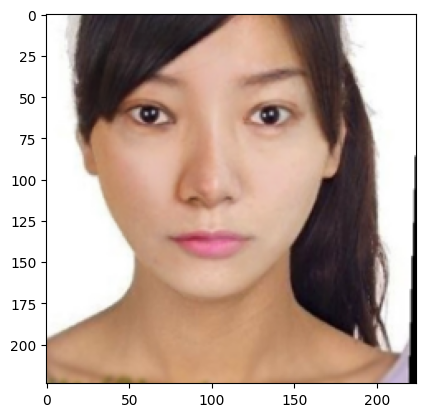

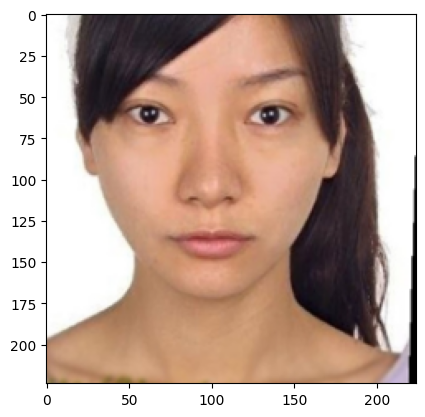

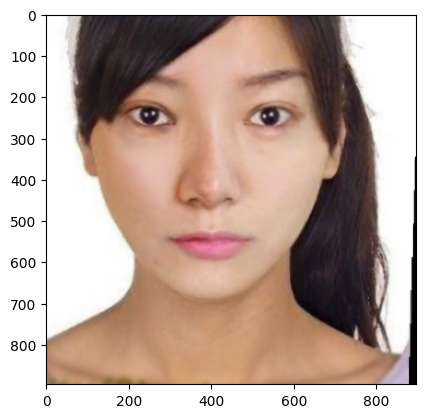

In [7]:

makeup_img, non_img, hr_img = load([str(IMG_PATH + '/train/makeup/0.png'),
                                    str(IMG_PATH + '/train/non-makeup/0.png'),
                                    str(IMG_PATH + '/train/high_r/0.png')
                                   ])
print(makeup_img.shape)
print(non_img.shape)
print(hr_img.shape)



# casting to int for matplotlib to show the image
plt.figure()
plt.imshow(makeup_img/255.0)
plt.figure()
plt.imshow(non_img/255.0)
plt.figure()
plt.imshow(hr_img/255.0)

In [8]:
@tf.function()
def random_flip(makeup_img, non_img, hr_img):
    if tf.random.uniform(()) > 0.5:
        # Random mirroring
        makeup_img = tf.image.flip_left_right(makeup_img)
        non_img = tf.image.flip_left_right(non_img)
        hr_img = tf.image.flip_left_right(hr_img)

    return makeup_img, non_img, hr_img


def processing_image(makeup_img, non_img, hr_img):
#     input_image = tf.keras.applications.resnet50.preprocess_input(input_image)
    makeup_img = (makeup_img / 255.0)
    non_img = (non_img / 255.0)
    hr_img = (hr_img /255.0)
    return makeup_img, non_img, hr_img


def load_image_train(image_file):
    makeup_img, non_img, hr_img = load(image_file)
    makeup_img, non_img, hr_img = random_flip(makeup_img, non_img, hr_img)
    makeup_img, non_img, hr_img = processing_image(makeup_img, non_img, hr_img)

    return makeup_img, non_img, hr_img


def load_image_val(image_file):
    makeup_img, non_img, hr_img = load(image_file)
    makeup_img, non_img, hr_img = processing_image(makeup_img, non_img, hr_img)

    return makeup_img, non_img, hr_img 

In [9]:
def prep_data(path):
    makeup_img_list = [os.path.join(path, f) for f in os.listdir(path)]
    data_list = [[i, i.replace('makeup','non-makeup'), i.replace('makeup','high_r')] for i in makeup_img_list]
    return data_list

train_data_list = prep_data(str(IMG_PATH + '/train/makeup/'))
val_data_list = prep_data(str(IMG_PATH + '/val/makeup/'))
test_data_list = prep_data(str(IMG_PATH + '/test/makeup/'))

np.random.shuffle(train_data_list)
np.random.shuffle(val_data_list)
np.random.shuffle(test_data_list)

In [10]:
train_dataset = tf.data.Dataset.from_tensor_slices(train_data_list)
train_dataset = train_dataset.map(load_image_train,
                                  num_parallel_calls=tf.data.AUTOTUNE)
train_dataset = train_dataset.shuffle(BUFFER_SIZE)
train_dataset = train_dataset.batch(BATCH_SIZE)


In [11]:
val_dataset = tf.data.Dataset.from_tensor_slices(val_data_list)
val_dataset = val_dataset.map(load_image_val)
val_dataset = val_dataset.batch(BATCH_SIZE)

In [12]:
test_dataset = tf.data.Dataset.from_tensor_slices(test_data_list)
test_dataset = test_dataset.map(load_image_val)
test_dataset = test_dataset.batch(BATCH_SIZE)

## Build Model 

In [13]:
class BuildResNet34():
    def __init__(self):
        pass

    def identity_block(self, inputs, filters):
        x = layers.Conv2D(filters=filters, kernel_size=(3,3), padding='same', use_bias=False)(inputs)
        x = tfa.layers.InstanceNormalization()(x)
        x = layers.Activation('gelu')(x)
        
        x = layers.Conv2D(filters=filters, kernel_size=(3,3), padding='same', use_bias=False)(x)
        x = tfa.layers.InstanceNormalization()(x)
        
        skip_connection = layers.add([inputs, x])     
        x = layers.Activation('gelu')(skip_connection)
        
        return x
    
    
    def projection_block(self, inputs, filters, strides=2):
        x = layers.Conv2D(filters=filters, kernel_size=(3,3), padding='same', strides=strides, use_bias=False)(inputs)
        x = tfa.layers.InstanceNormalization()(x)
        x = layers.Activation('gelu')(x)
        
        x = layers.Conv2D(filters=filters, kernel_size=(3,3), padding='same', use_bias=False)(x)
        x = tfa.layers.InstanceNormalization()(x)
        
        shortcut = layers.Conv2D(filters=filters, kernel_size=(1,1), padding='same', 
                                 strides=strides, use_bias=False)(inputs)
        shortcut = tfa.layers.InstanceNormalization()(shortcut)
        skip_connection = layers.add([shortcut, x])        
        x = layers.Activation('gelu')(skip_connection)
        
        return x
    
    def build_model(self, classes, inputs):        
        # conv1
        x = layers.ZeroPadding2D(padding=((3, 3)))(inputs)
        x = layers.Conv2D(64, 7, strides=2, use_bias=False)(x)
        x = tfa.layers.InstanceNormalization()(x)
        x = layers.Activation('gelu')(x)
        x = layers.ZeroPadding2D(padding=((1, 1)))(x)
        x = layers.MaxPooling2D(3, strides=2)(x)
        
        # conv2_X
        x = self.identity_block(x, filters=64)
        x = self.identity_block(x, filters=64)
        x = self.identity_block(x, filters=64)
        
        # conv3_x
        x = self.projection_block(x, filters=128)
        x = self.identity_block(x, filters=128)
        x = self.identity_block(x, filters=128)
        x = self.identity_block(x, filters=128)
        
        # conv4_x
        x = self.projection_block(x, filters=256)
        x = self.identity_block(x, filters=256)
        x = self.identity_block(x, filters=256)
        x = self.identity_block(x, filters=256)
        x = self.identity_block(x, filters=256)
        x = self.identity_block(x, filters=256)
        
        # conv5_x
        x = self.projection_block(x, filters=512)
        x = self.identity_block(x, filters=512)
        x = self.identity_block(x, filters=512)
        
        x = layers.GlobalAveragePooling2D()(x)
        outputs = layers.Dense(classes, activation='softmax')(x)
        
        model = Model(inputs=inputs, outputs=outputs)

        return model
        

In [14]:
class BuildRes34Unet():
    def __init__(self):
        
        self.encoder_blocks_id = [4, 27, 57, 101]
        self.bridge_block_id = 124
        
    
    def conv_block(self, inputs, num_filters):
        x = layers.Conv2D(filters=num_filters, kernel_size=(3,3), padding="same")(inputs)
        x = tfa.layers.InstanceNormalization()(x)
        x = layers.Activation('gelu')(x)
        
        return x
    
    
    def upsample_concate_block(self, inputs, skip_connection, num_filters):
        x = layers.Conv2DTranspose(filters=num_filters, kernel_size=(2,2), strides=2, padding='same')(inputs)
        x = layers.Concatenate()([skip_connection, x])
        x = self.conv_block(x, num_filters)
        
        return x
    
    
    def build_model(self, input_shape):
        inputs = layers.Input(shape=input_shape)
        
        # encoder
        build_resnet34 = BuildResNet34()
        backbone = build_resnet34.build_model(classes=1000,  inputs=inputs)
        
        eb0 = backbone.get_layer(index=self.encoder_blocks_id[0]).output
        eb1 = backbone.get_layer(index=self.encoder_blocks_id[1]).output
        eb2 = backbone.get_layer(index=self.encoder_blocks_id[2]).output
        eb3 = backbone.get_layer(index=self.encoder_blocks_id[3]).output
        
        # bridge
        br = backbone.get_layer(index=self.bridge_block_id).output
        
        # decoder
        db3 = self.upsample_concate_block(inputs=br, skip_connection=eb3, num_filters=512)
        db2 = self.upsample_concate_block(inputs=db3, skip_connection=eb2, num_filters=256)
        db1 = self.upsample_concate_block(inputs=db2, skip_connection=eb1, num_filters=128)
        db0 = self.upsample_concate_block(inputs=db1, skip_connection=eb0, num_filters=64)
        
        # final output 4, 27, 57, 101, 124
        first_feature = layers.Conv2D(filters=64, kernel_size=(3,3), padding='same')(inputs)
        final_feature = self.upsample_concate_block(inputs=db0, skip_connection=first_feature, num_filters=64)
        
        non_feature = self.conv_block(final_feature, num_filters=32)
        non_feature = self.conv_block(non_feature, num_filters=16)
        outputs1 = layers.Conv2D(filters=3, kernel_size=(1,1), activation='sigmoid')(non_feature)
        
        sr_feature = layers.Conv2DTranspose(filters=32, kernel_size=(2,2), 
                                            strides=2, padding='same')(final_feature)

        sr_feature = layers.Conv2DTranspose(filters=16, kernel_size=(2,2), 
                                            strides=2, padding='same')(sr_feature)
        outputs2 = layers.Conv2D(filters=3, kernel_size=(1,1), activation='sigmoid')(sr_feature)
        
        model = Model(inputs=inputs, outputs=[outputs1, outputs2])
        
        return  model

In [15]:
model = BuildRes34Unet()
res34Unet = model.build_model(input_shape=(IMG_HEGIHT, IMG_WIDHT, IMG_CHANNEL))

In [16]:
res34Unet.summary()

Model: "model_1"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_1 (InputLayer)           [(None, 224, 224, 3  0           []                               
                                )]                                                                
                                                                                                  
 zero_padding2d (ZeroPadding2D)  (None, 230, 230, 3)  0          ['input_1[0][0]']                
                                                                                                  
 conv2d (Conv2D)                (None, 112, 112, 64  9408        ['zero_padding2d[0][0]']         
                                )                                                                 
                                                                                            

                                                                                                  
 activation_7 (Activation)      (None, 28, 28, 128)  0           ['instance_normalization_7[0][0]'
                                                                 ]                                
                                                                                                  
 conv2d_9 (Conv2D)              (None, 28, 28, 128)  8192        ['activation_6[0][0]']           
                                                                                                  
 conv2d_8 (Conv2D)              (None, 28, 28, 128)  147456      ['activation_7[0][0]']           
                                                                                                  
 instance_normalization_9 (Inst  (None, 28, 28, 128)  256        ['conv2d_9[0][0]']               
 anceNormalization)                                                                               
          

                                                                 ']                               
                                                                                                  
 conv2d_18 (Conv2D)             (None, 14, 14, 256)  32768       ['activation_14[0][0]']          
                                                                                                  
 conv2d_17 (Conv2D)             (None, 14, 14, 256)  589824      ['activation_15[0][0]']          
                                                                                                  
 instance_normalization_18 (Ins  (None, 14, 14, 256)  512        ['conv2d_18[0][0]']              
 tanceNormalization)                                                                              
                                                                                                  
 instance_normalization_17 (Ins  (None, 14, 14, 256)  512        ['conv2d_17[0][0]']              
 tanceNorm

                                                                                                  
 conv2d_26 (Conv2D)             (None, 14, 14, 256)  589824      ['activation_23[0][0]']          
                                                                                                  
 instance_normalization_26 (Ins  (None, 14, 14, 256)  512        ['conv2d_26[0][0]']              
 tanceNormalization)                                                                              
                                                                                                  
 add_11 (Add)                   (None, 14, 14, 256)  0           ['activation_22[0][0]',          
                                                                  'instance_normalization_26[0][0]
                                                                 ']                               
                                                                                                  
 activatio

 conv2d_35 (Conv2D)             (None, 7, 7, 512)    2359296     ['activation_31[0][0]']          
                                                                                                  
 instance_normalization_35 (Ins  (None, 7, 7, 512)   1024        ['conv2d_35[0][0]']              
 tanceNormalization)                                                                              
                                                                                                  
 add_15 (Add)                   (None, 7, 7, 512)    0           ['activation_30[0][0]',          
                                                                  'instance_normalization_35[0][0]
                                                                 ']                               
                                                                                                  
 activation_32 (Activation)     (None, 7, 7, 512)    0           ['add_15[0][0]']                 
          

 activation_37 (Activation)     (None, 224, 224, 64  0           ['instance_normalization_40[0][0]
                                )                                ']                               
                                                                                                  
 conv2d_42 (Conv2D)             (None, 224, 224, 32  18464       ['activation_37[0][0]']          
                                )                                                                 
                                                                                                  
 instance_normalization_41 (Ins  (None, 224, 224, 32  64         ['conv2d_42[0][0]']              
 tanceNormalization)            )                                                                 
                                                                                                  
 activation_38 (Activation)     (None, 224, 224, 32  0           ['instance_normalization_41[0][0]
          

## Config and Compile Model

### Show Generated Images and Evaluation Function

In [18]:
def evaluate(model, epoch, dataset):  
    psnr_non_mean = 0.0
    psnr_sr_mean = 0.0
    count = 0
    for makeup_img, non_img, hr_img in dataset:
        
        pred_non, pred_sr = model([makeup_img], training=False)
        
        psnr_non = tf.image.psnr(pred_non, non_img, max_val=1.0)
        psnr_sr = tf.image.psnr(pred_sr, hr_img, max_val=1.0)

        __psnr_non_mean = tf.math.reduce_mean(psnr_non)
        __psnr_sr_mean = tf.math.reduce_mean(psnr_sr)
        # psnr_mean = psnr_mean_l
        
        psnr_non_mean += __psnr_non_mean
        psnr_sr_mean += __psnr_sr_mean
        count =count + 1
    
    psnr_non_mean = psnr_non_mean/count
    psnr_sr_mean = psnr_sr_mean/count
    print('-------- psnr_non: ', psnr_non_mean.numpy(),  'psnr_sr: ', psnr_sr_mean.numpy(), '   ----- epoch: ', epoch, '  count: ', count)
    
    return psnr_non_mean, psnr_sr_mean
    

def generate_images(model, makeup_img, non_img, hr_img):
    pred_non, pred_sr = model([makeup_img], training=False)
    plt.figure(figsize=(15,20))
    
    display_list = [makeup_img[0], non_img[0], pred_non[0]]
    
    
    title = ['Input', 'Non-makeup', 'Predicted']    

    for i in range(3):
        plt.subplot(1, 3, i+1)
        plt.title(title[i])
        plt.imshow(display_list[i])
        plt.axis('off')
    plt.show()
    
    display_list2 = [hr_img[0], pred_sr[0]]
    title2 = ['Target', 'Pred_SR']
    for i in range(2):
        plt.subplot(1, 2, i+1)
        plt.title(title2[i])
        plt.imshow(display_list2[i])
        plt.axis('off')
    plt.show()

### Optimizer

In [19]:
from official.nlp import optimization  # to create AdamW optimizer
steps_per_epoch = tf.data.experimental.cardinality(train_dataset).numpy()
num_train_steps = steps_per_epoch * EPOCHS
num_warmup_steps = int(0.1*num_train_steps)

init_lr = 1e-2
generator_optimizer = optimization.create_optimizer(init_lr=init_lr,
                                          num_train_steps=num_train_steps,
                                          num_warmup_steps=num_warmup_steps,
                                          optimizer_type='adamw')

## Training

In [20]:

@tf.function
def train_step(model, makeup_img, non_img, hr_img):
    with tf.GradientTape() as tape:
        # output
        pred_non, pred_sr = model([makeup_img], training=True)     
        loss_non = tf.reduce_mean(tf.square(pred_non-non_img))*100
        loss_sr = tf.reduce_mean(tf.square(pred_sr-hr_img))*100
        loss = 2*loss_non + loss_sr
        
    generator_gradients = tape.gradient(loss, model.trainable_variables)
    generator_optimizer.apply_gradients(zip(generator_gradients, model.trainable_variables))
    
    return loss

    
    
def fit(model, train_ds, epochs, val_ds):
    best_pnsr = 0.0
    step_counter = 0
    for epoch in range(epochs):
        # Train
        total_loss = 0.0
        for makeup_img, non_img, hr_img in train_ds:
            loss = train_step(model, makeup_img, non_img, hr_img)
            total_loss = total_loss + loss
            step_counter += 1
        total_loss = total_loss/step_counter
        print('epoch: {}   loss: {}'.format(epoch, total_loss))
        
        pnsr = tf.reduce_mean(evaluate(model, epoch, val_ds))        
        if best_pnsr < pnsr:
            best_pnsr = pnsr
            
            for makeup_img, non_img, hr_img in val_ds.take(1):
                generate_images(model, makeup_img, non_img, hr_img)


In [21]:
from time import time

2023-02-01 22:17:17.413288: I tensorflow/stream_executor/cuda/cuda_dnn.cc:368] Loaded cuDNN version 8302


epoch: 0   loss: 12.852036476135254


2023-02-01 22:19:42.039468: I tensorflow/stream_executor/cuda/cuda_blas.cc:1786] TensorFloat-32 will be used for the matrix multiplication. This will only be logged once.


-------- psnr_non:  19.359255 psnr_sr:  17.820446    ----- epoch:  0   count:  8


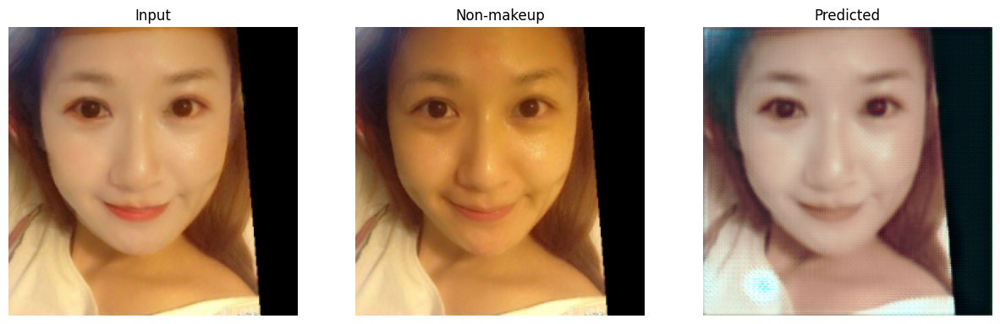

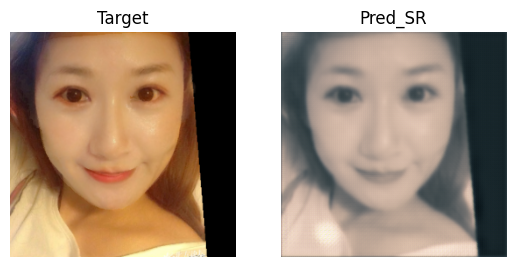

epoch: 1   loss: 1.5277550220489502
-------- psnr_non:  21.314278 psnr_sr:  23.407335    ----- epoch:  1   count:  8


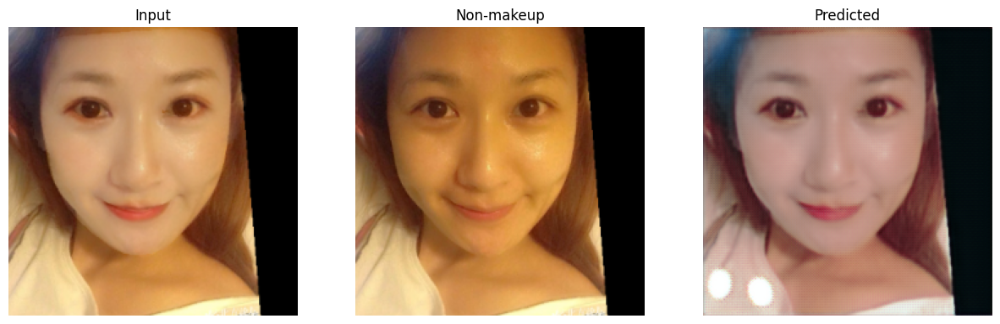

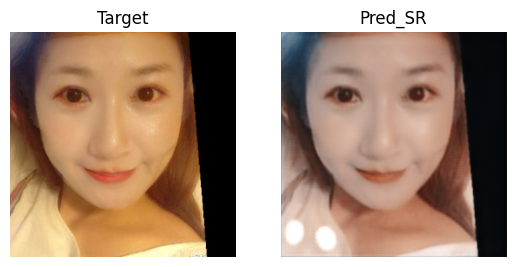

epoch: 2   loss: 0.6923489570617676
-------- psnr_non:  22.008608 psnr_sr:  24.525373    ----- epoch:  2   count:  8


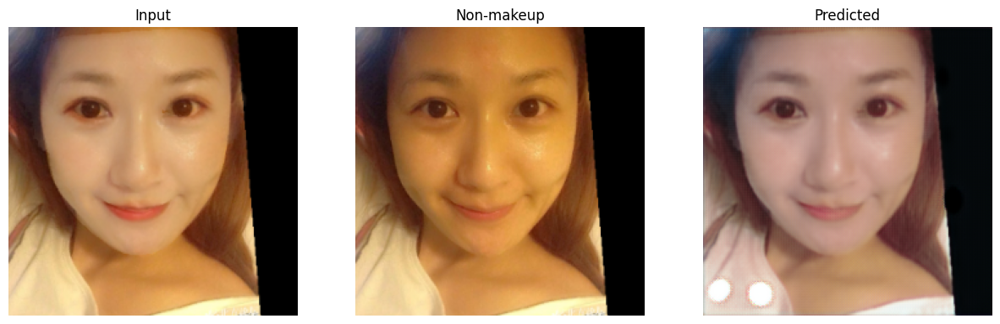

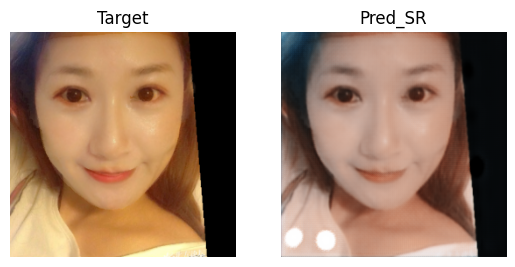

epoch: 3   loss: 0.4555263817310333
-------- psnr_non:  21.02912 psnr_sr:  24.108652    ----- epoch:  3   count:  8
epoch: 4   loss: 0.35305699706077576
-------- psnr_non:  23.098726 psnr_sr:  25.982475    ----- epoch:  4   count:  8


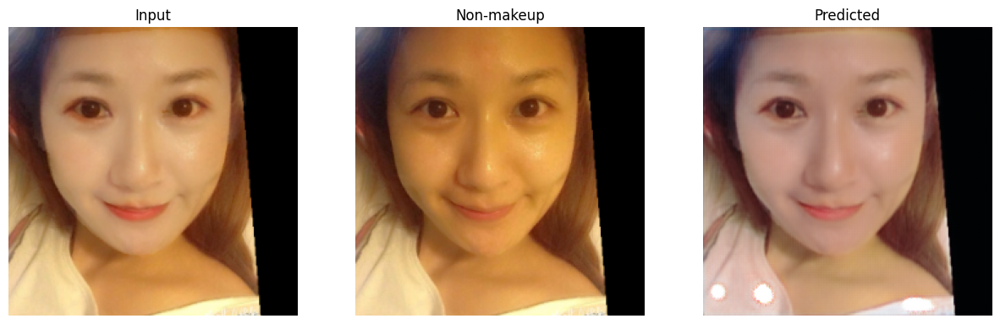

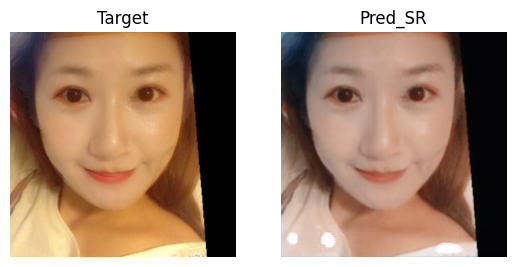

epoch: 5   loss: 0.24368879199028015
-------- psnr_non:  22.445599 psnr_sr:  25.396646    ----- epoch:  5   count:  8
epoch: 6   loss: 0.20146562159061432
-------- psnr_non:  23.755043 psnr_sr:  27.193312    ----- epoch:  6   count:  8


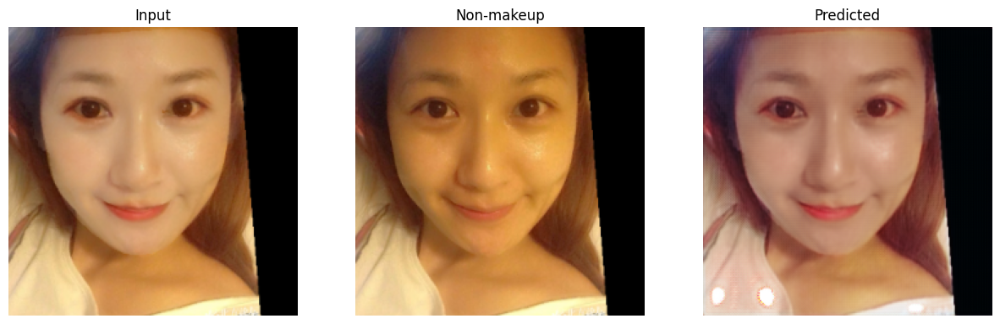

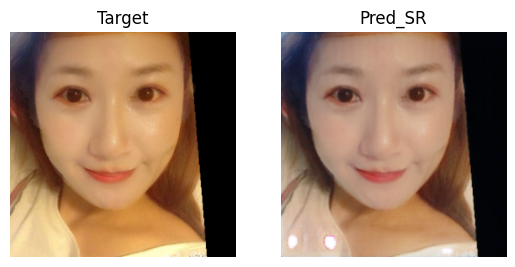

epoch: 7   loss: 0.1549902707338333
-------- psnr_non:  22.851707 psnr_sr:  25.82483    ----- epoch:  7   count:  8
epoch: 8   loss: 0.13021309673786163
-------- psnr_non:  23.636154 psnr_sr:  27.510117    ----- epoch:  8   count:  8


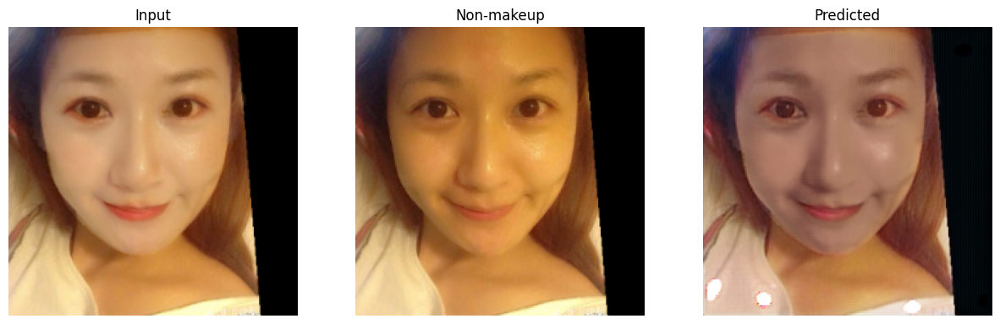

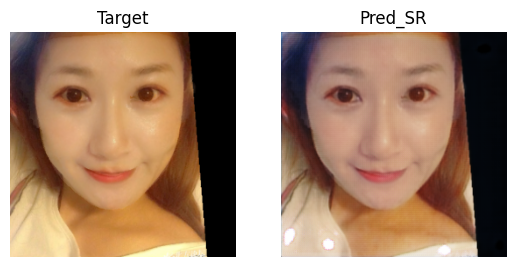

epoch: 9   loss: 0.1109870970249176
-------- psnr_non:  23.643135 psnr_sr:  27.281403    ----- epoch:  9   count:  8
epoch: 10   loss: 0.09746211022138596
-------- psnr_non:  24.280964 psnr_sr:  27.8732    ----- epoch:  10   count:  8


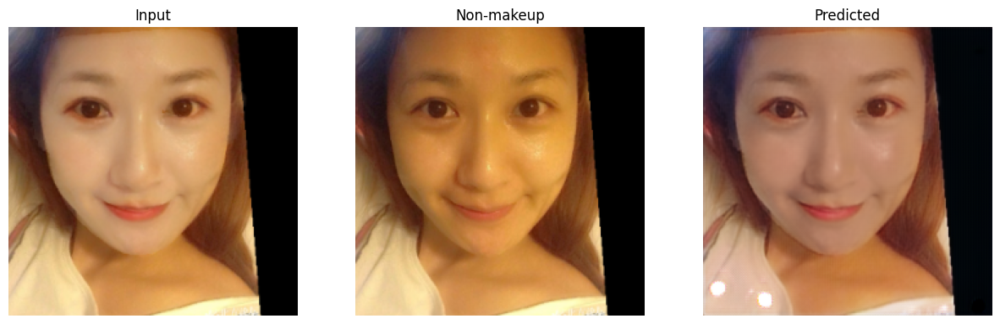

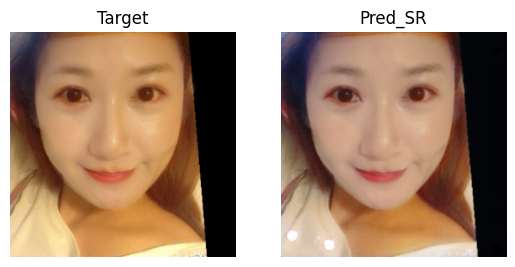

epoch: 11   loss: 0.09395235776901245
-------- psnr_non:  23.719425 psnr_sr:  27.003735    ----- epoch:  11   count:  8
epoch: 12   loss: 0.07121783494949341
-------- psnr_non:  24.407017 psnr_sr:  27.744823    ----- epoch:  12   count:  8
epoch: 13   loss: 0.0632789358496666
-------- psnr_non:  24.305466 psnr_sr:  27.393112    ----- epoch:  13   count:  8
epoch: 14   loss: 0.0586855411529541
-------- psnr_non:  24.558638 psnr_sr:  28.400412    ----- epoch:  14   count:  8


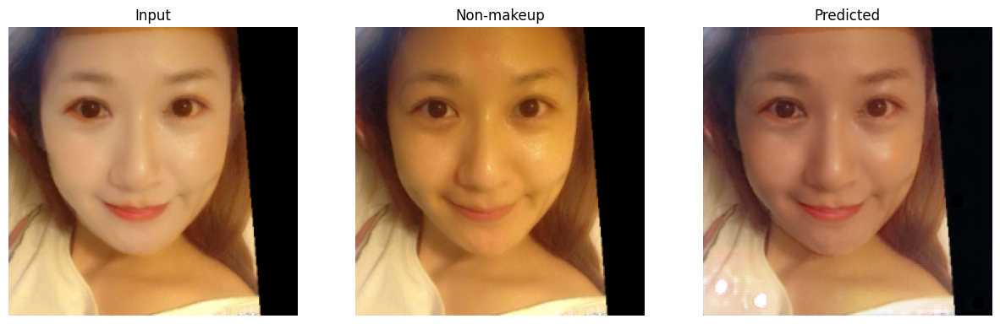

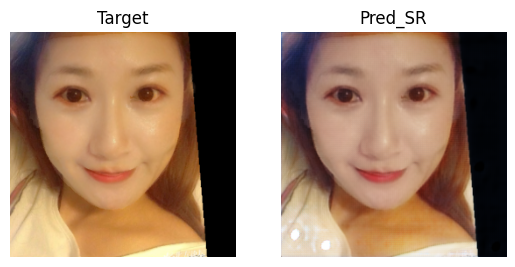

epoch: 15   loss: 0.04962683469057083
-------- psnr_non:  24.686993 psnr_sr:  27.792572    ----- epoch:  15   count:  8
epoch: 16   loss: 0.04701949283480644
-------- psnr_non:  24.612473 psnr_sr:  28.447325    ----- epoch:  16   count:  8


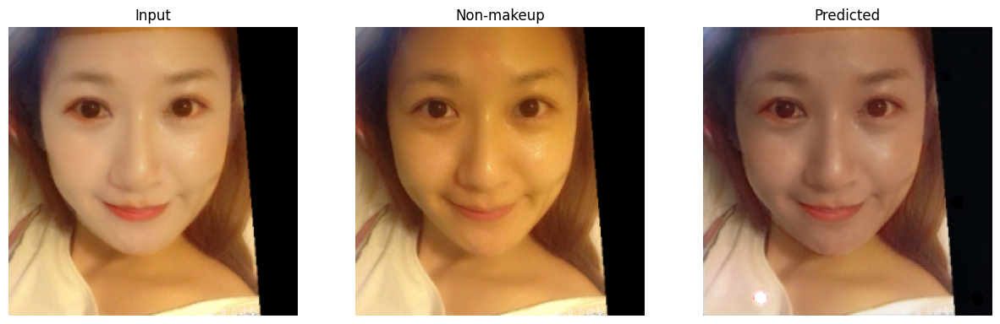

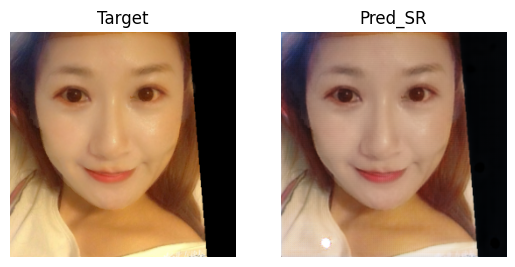

epoch: 17   loss: 0.041924502700567245
-------- psnr_non:  24.662422 psnr_sr:  27.755789    ----- epoch:  17   count:  8
epoch: 18   loss: 0.03891894221305847
-------- psnr_non:  24.785137 psnr_sr:  28.812826    ----- epoch:  18   count:  8


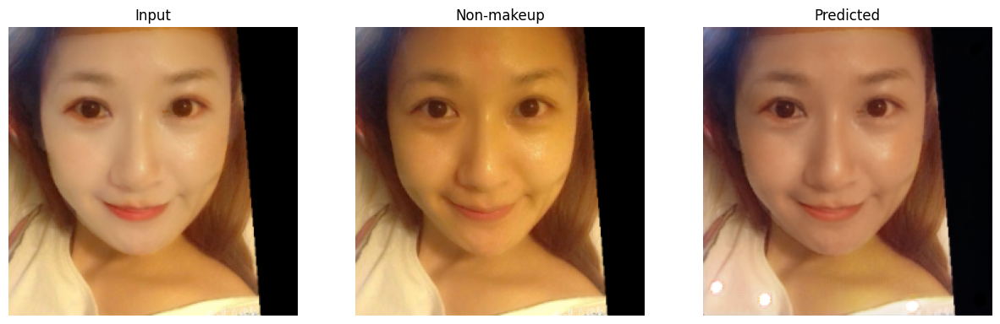

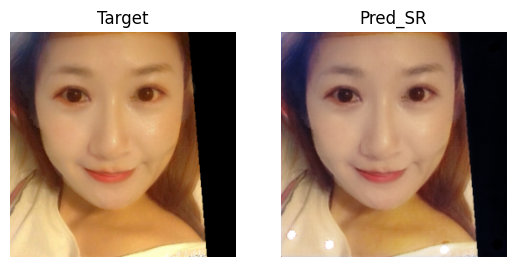

epoch: 19   loss: 0.03486846759915352
-------- psnr_non:  24.19962 psnr_sr:  28.712744    ----- epoch:  19   count:  8
epoch: 20   loss: 0.031464070081710815
-------- psnr_non:  24.681593 psnr_sr:  28.236929    ----- epoch:  20   count:  8
epoch: 21   loss: 0.02929341234266758
-------- psnr_non:  24.856579 psnr_sr:  28.875788    ----- epoch:  21   count:  8


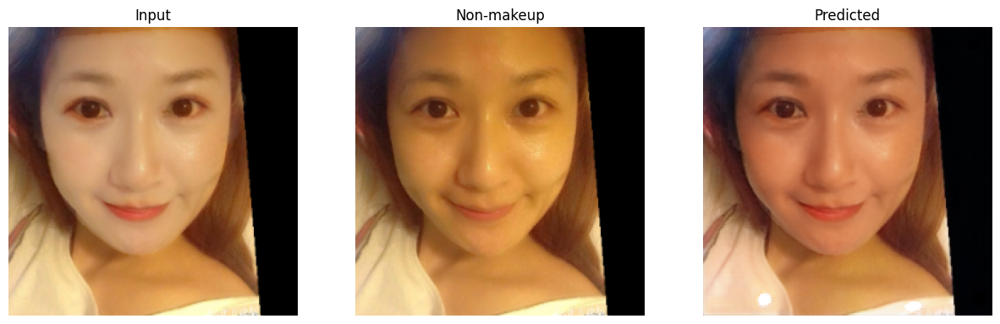

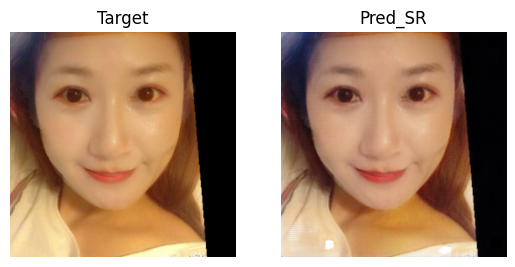

epoch: 22   loss: 0.02647744119167328
-------- psnr_non:  25.274345 psnr_sr:  28.036308    ----- epoch:  22   count:  8
epoch: 23   loss: 0.02307397872209549
-------- psnr_non:  24.830341 psnr_sr:  29.32655    ----- epoch:  23   count:  8


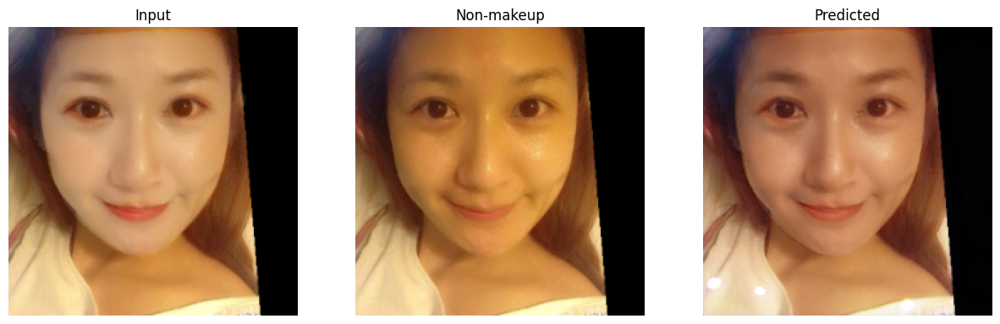

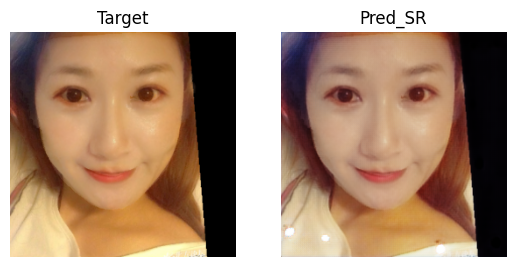

epoch: 24   loss: 0.020821865648031235
-------- psnr_non:  25.487482 psnr_sr:  29.47566    ----- epoch:  24   count:  8


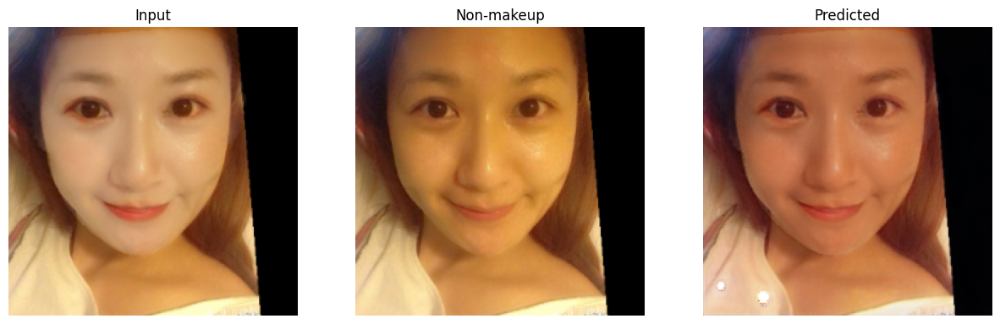

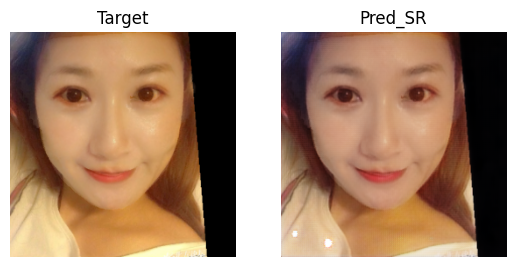

epoch: 25   loss: 0.01946498639881611
-------- psnr_non:  24.886845 psnr_sr:  28.651894    ----- epoch:  25   count:  8
epoch: 26   loss: 0.018339646980166435
-------- psnr_non:  24.741562 psnr_sr:  28.466904    ----- epoch:  26   count:  8
epoch: 27   loss: 0.016596738249063492
-------- psnr_non:  25.201576 psnr_sr:  28.647198    ----- epoch:  27   count:  8
epoch: 28   loss: 0.01612834632396698
-------- psnr_non:  25.542368 psnr_sr:  29.118824    ----- epoch:  28   count:  8
epoch: 29   loss: 0.015859052538871765
-------- psnr_non:  25.103828 psnr_sr:  28.82575    ----- epoch:  29   count:  8
epoch: 30   loss: 0.013199199922382832
-------- psnr_non:  26.114212 psnr_sr:  30.545858    ----- epoch:  30   count:  8


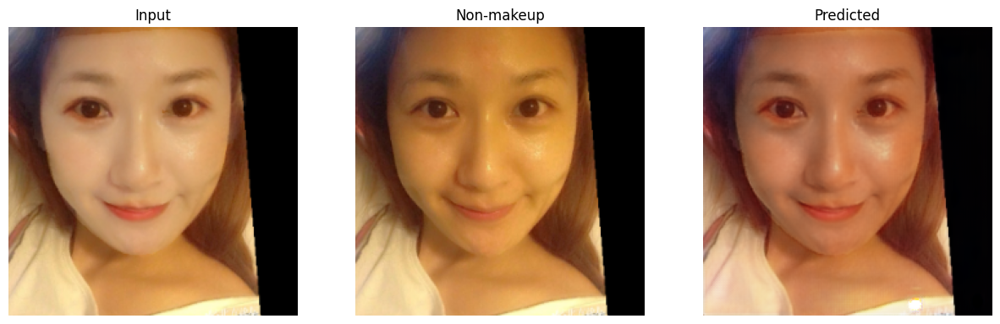

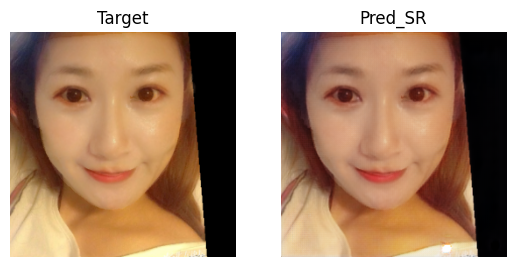

epoch: 31   loss: 0.011878806166350842
-------- psnr_non:  25.60016 psnr_sr:  29.490454    ----- epoch:  31   count:  8
epoch: 32   loss: 0.010162816382944584
-------- psnr_non:  25.321308 psnr_sr:  28.78742    ----- epoch:  32   count:  8
epoch: 33   loss: 0.010769490152597427
-------- psnr_non:  25.356113 psnr_sr:  29.677639    ----- epoch:  33   count:  8
epoch: 34   loss: 0.008437256328761578
-------- psnr_non:  25.854004 psnr_sr:  30.48098    ----- epoch:  34   count:  8
epoch: 35   loss: 0.007498795632272959
-------- psnr_non:  26.134357 psnr_sr:  31.002142    ----- epoch:  35   count:  8


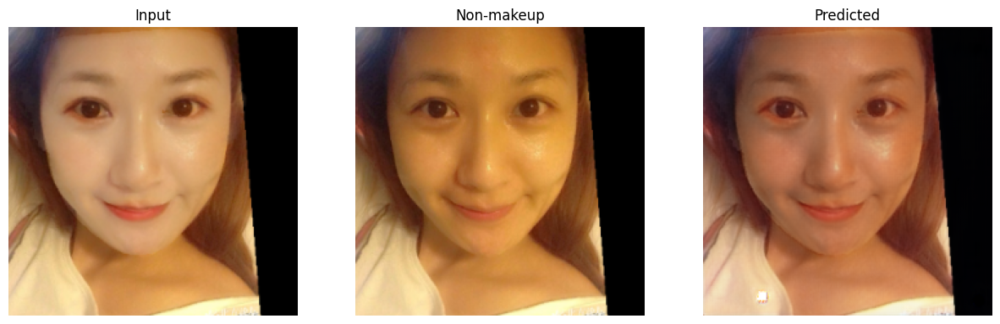

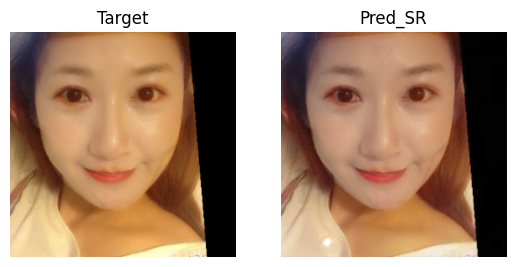

epoch: 36   loss: 0.007517168764024973
-------- psnr_non:  25.969942 psnr_sr:  30.591272    ----- epoch:  36   count:  8
epoch: 37   loss: 0.0072766453959047794
-------- psnr_non:  25.553833 psnr_sr:  30.541962    ----- epoch:  37   count:  8
epoch: 38   loss: 0.006885963957756758
-------- psnr_non:  26.103285 psnr_sr:  31.29666    ----- epoch:  38   count:  8


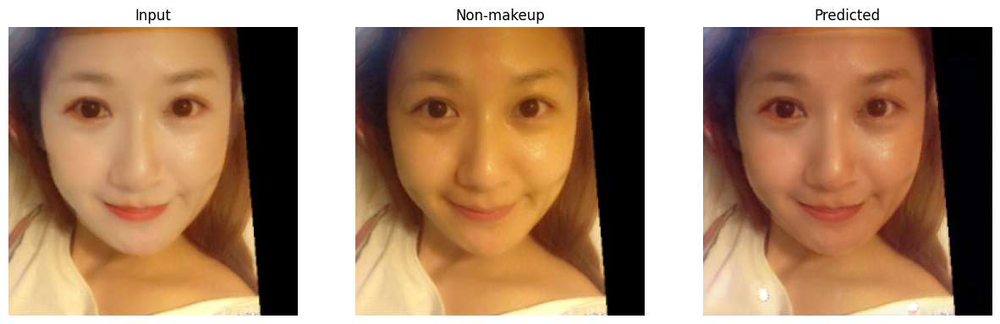

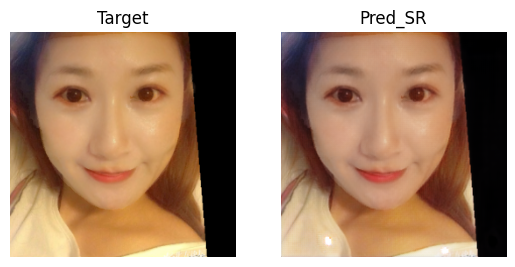

epoch: 39   loss: 0.006372413132339716
-------- psnr_non:  26.203999 psnr_sr:  31.077358    ----- epoch:  39   count:  8
epoch: 40   loss: 0.006444156169891357
-------- psnr_non:  25.858686 psnr_sr:  30.543045    ----- epoch:  40   count:  8
epoch: 41   loss: 0.005871862638741732
-------- psnr_non:  25.44132 psnr_sr:  30.40119    ----- epoch:  41   count:  8
epoch: 42   loss: 0.005195437464863062
-------- psnr_non:  26.164295 psnr_sr:  31.146332    ----- epoch:  42   count:  8
epoch: 43   loss: 0.004901670850813389
-------- psnr_non:  26.11958 psnr_sr:  31.220583    ----- epoch:  43   count:  8
epoch: 44   loss: 0.005168525967746973
-------- psnr_non:  26.09703 psnr_sr:  31.477932    ----- epoch:  44   count:  8


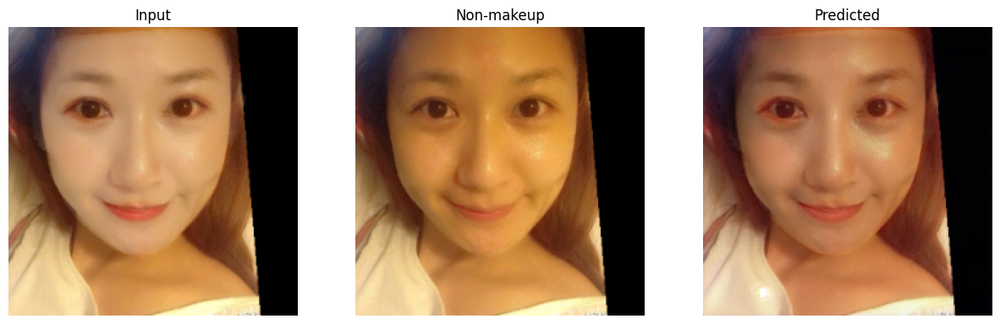

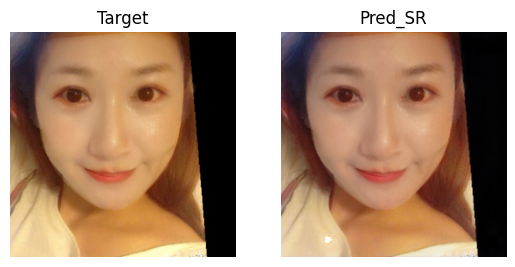

epoch: 45   loss: 0.0044047958217561245
-------- psnr_non:  26.192478 psnr_sr:  31.567276    ----- epoch:  45   count:  8


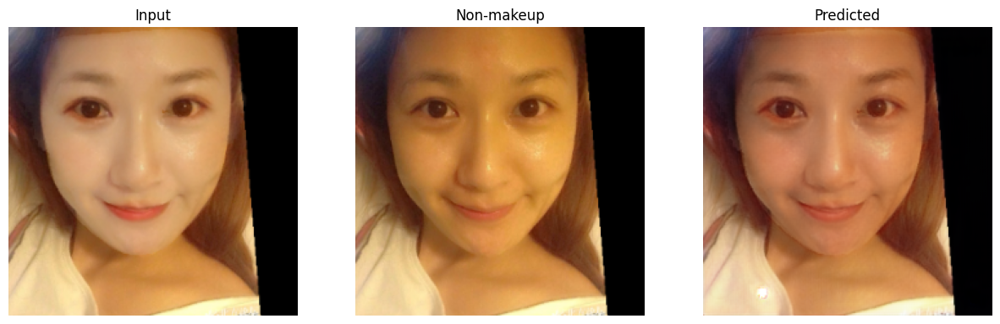

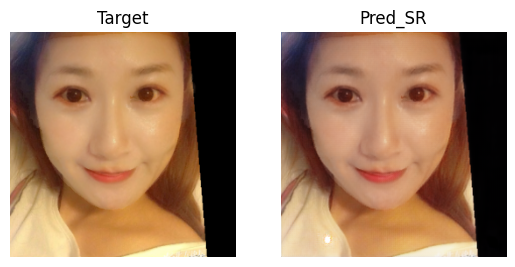

epoch: 46   loss: 0.004230804275721312
-------- psnr_non:  26.111362 psnr_sr:  31.079575    ----- epoch:  46   count:  8
epoch: 47   loss: 0.003736745798960328
-------- psnr_non:  26.167547 psnr_sr:  31.719921    ----- epoch:  47   count:  8


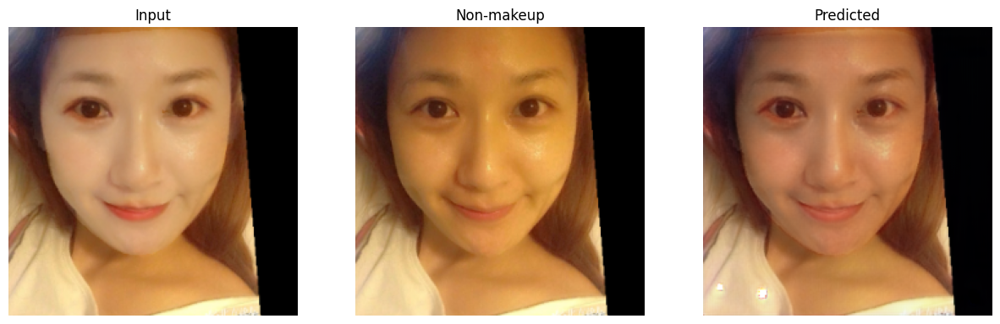

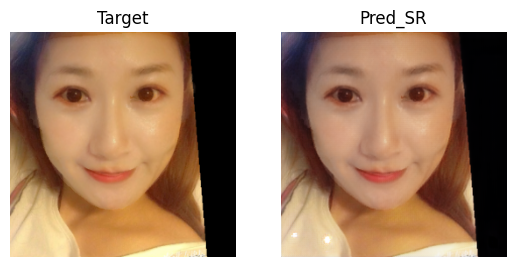

epoch: 48   loss: 0.004377236124128103
-------- psnr_non:  25.847637 psnr_sr:  30.932106    ----- epoch:  48   count:  8
epoch: 49   loss: 0.004152360837906599
-------- psnr_non:  26.134933 psnr_sr:  31.216324    ----- epoch:  49   count:  8
epoch: 50   loss: 0.0041969758458435535
-------- psnr_non:  26.437471 psnr_sr:  31.990253    ----- epoch:  50   count:  8


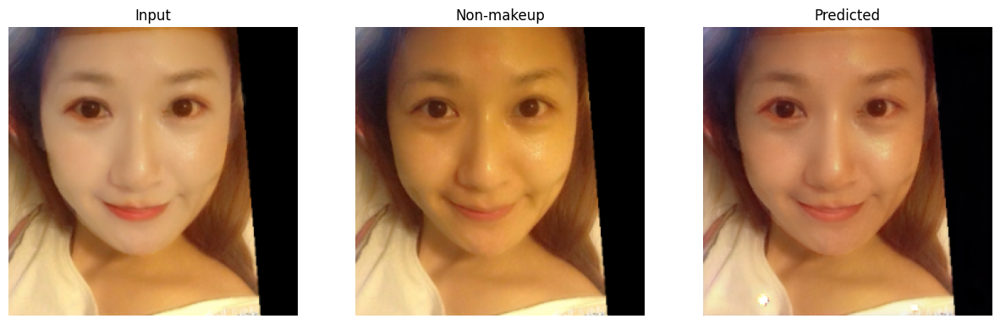

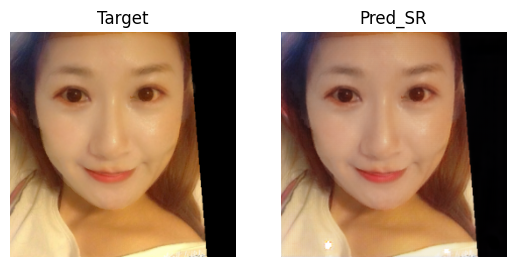

epoch: 51   loss: 0.0033136869315057993
-------- psnr_non:  26.352428 psnr_sr:  31.978977    ----- epoch:  51   count:  8
epoch: 52   loss: 0.0034854556433856487
-------- psnr_non:  26.128437 psnr_sr:  31.544847    ----- epoch:  52   count:  8
epoch: 53   loss: 0.003195534460246563
-------- psnr_non:  26.07951 psnr_sr:  31.396019    ----- epoch:  53   count:  8
epoch: 54   loss: 0.002902965759858489
-------- psnr_non:  26.313246 psnr_sr:  32.2024    ----- epoch:  54   count:  8


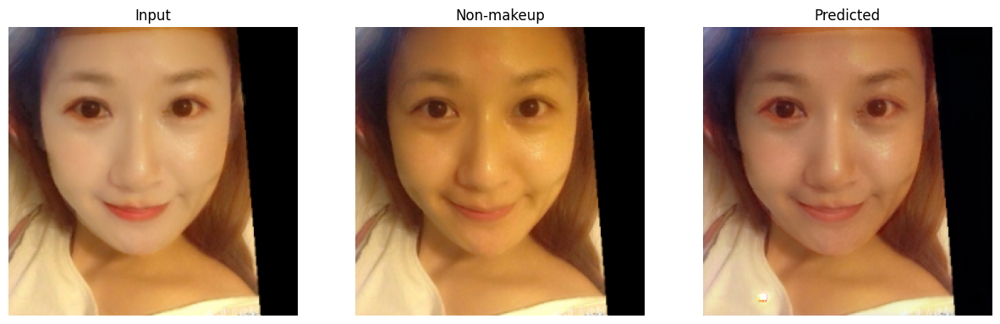

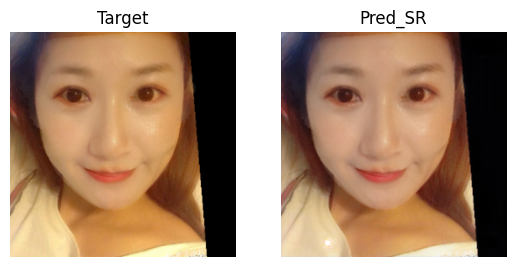

epoch: 55   loss: 0.0026023252867162228
-------- psnr_non:  26.459934 psnr_sr:  32.2956    ----- epoch:  55   count:  8


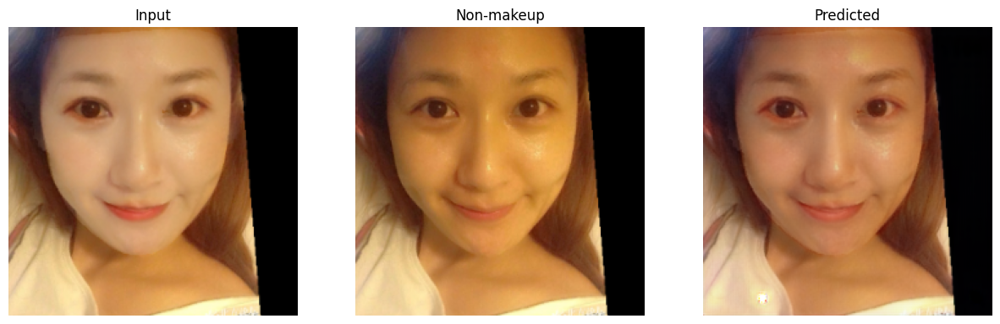

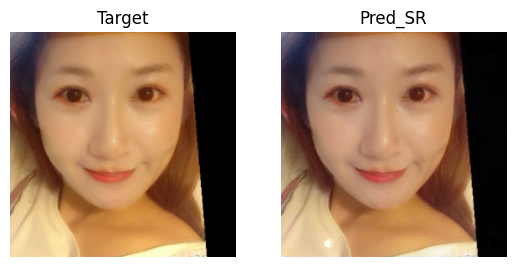

epoch: 56   loss: 0.0024257975164800882
-------- psnr_non:  26.318472 psnr_sr:  32.017815    ----- epoch:  56   count:  8
epoch: 57   loss: 0.002532873535528779
-------- psnr_non:  26.44523 psnr_sr:  32.09582    ----- epoch:  57   count:  8
epoch: 58   loss: 0.00274272239767015
-------- psnr_non:  26.29519 psnr_sr:  31.895885    ----- epoch:  58   count:  8
epoch: 59   loss: 0.0030760944355279207
-------- psnr_non:  25.975554 psnr_sr:  30.600351    ----- epoch:  59   count:  8
epoch: 60   loss: 0.0027371845208108425
-------- psnr_non:  26.092476 psnr_sr:  32.1668    ----- epoch:  60   count:  8
epoch: 61   loss: 0.0027035840321332216
-------- psnr_non:  25.821096 psnr_sr:  31.527119    ----- epoch:  61   count:  8
epoch: 62   loss: 0.002695623319596052
-------- psnr_non:  26.048658 psnr_sr:  31.972132    ----- epoch:  62   count:  8
epoch: 63   loss: 0.0019890691619366407
-------- psnr_non:  26.413614 psnr_sr:  32.324196    ----- epoch:  63   count:  8
epoch: 64   loss: 0.0019624419510

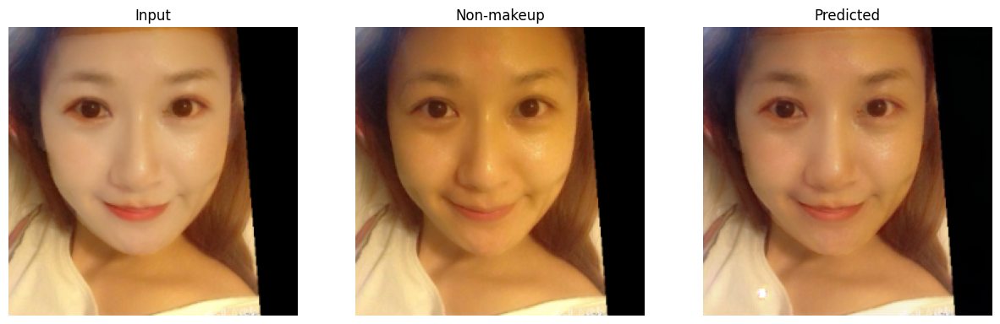

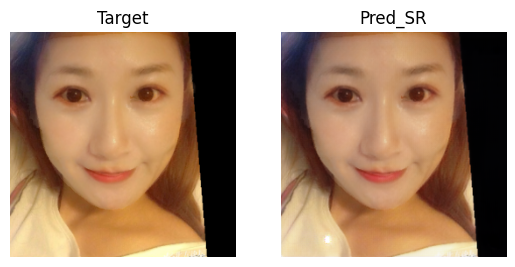

epoch: 73   loss: 0.0014715605648234487
-------- psnr_non:  25.986115 psnr_sr:  32.15624    ----- epoch:  73   count:  8
epoch: 74   loss: 0.0017271062824875116
-------- psnr_non:  25.768608 psnr_sr:  32.44548    ----- epoch:  74   count:  8
epoch: 75   loss: 0.0017071081092581153
-------- psnr_non:  25.90003 psnr_sr:  31.241037    ----- epoch:  75   count:  8
epoch: 76   loss: 0.0017503465060144663
-------- psnr_non:  25.97874 psnr_sr:  31.784945    ----- epoch:  76   count:  8
epoch: 77   loss: 0.0012972683180123568
-------- psnr_non:  26.371685 psnr_sr:  32.560444    ----- epoch:  77   count:  8


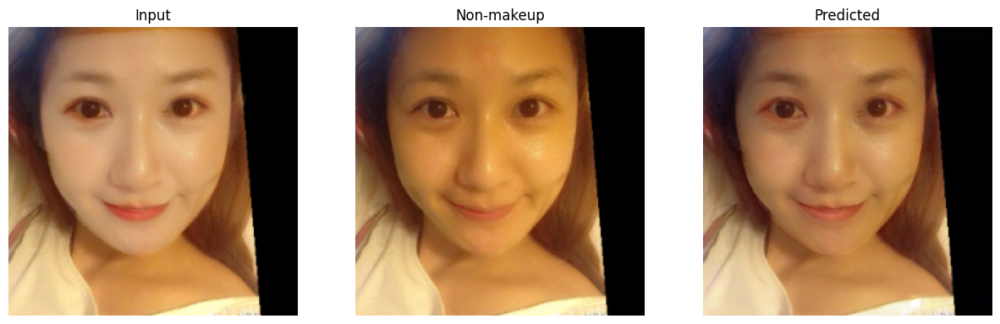

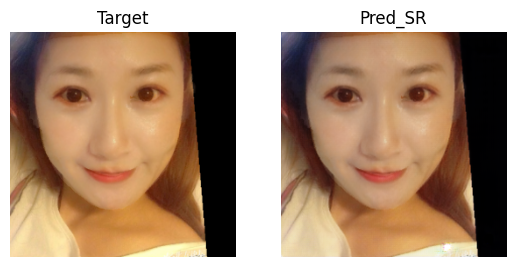

epoch: 78   loss: 0.001423660316504538
-------- psnr_non:  26.244951 psnr_sr:  32.423054    ----- epoch:  78   count:  8
epoch: 79   loss: 0.001215898897498846
-------- psnr_non:  25.964033 psnr_sr:  31.990063    ----- epoch:  79   count:  8
epoch: 80   loss: 0.0013325989712029696
-------- psnr_non:  26.257006 psnr_sr:  32.27494    ----- epoch:  80   count:  8
epoch: 81   loss: 0.001339885056950152
-------- psnr_non:  26.043703 psnr_sr:  32.12831    ----- epoch:  81   count:  8
epoch: 82   loss: 0.0012704494874924421
-------- psnr_non:  26.036743 psnr_sr:  32.08501    ----- epoch:  82   count:  8
epoch: 83   loss: 0.001595840323716402
-------- psnr_non:  25.883753 psnr_sr:  31.662867    ----- epoch:  83   count:  8
epoch: 84   loss: 0.001397171407006681
-------- psnr_non:  26.01588 psnr_sr:  31.36461    ----- epoch:  84   count:  8
epoch: 85   loss: 0.0014028737787157297
-------- psnr_non:  25.983013 psnr_sr:  31.229773    ----- epoch:  85   count:  8
epoch: 86   loss: 0.00155941816046

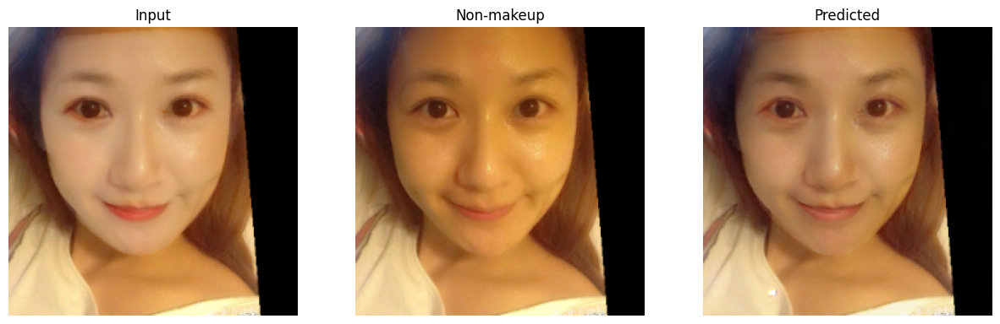

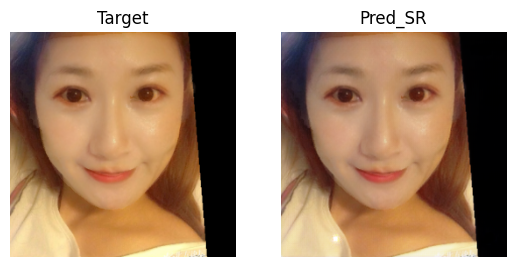

epoch: 110   loss: 0.0006758348317816854
-------- psnr_non:  26.279215 psnr_sr:  32.66218    ----- epoch:  110   count:  8
epoch: 111   loss: 0.0006788541213609278
-------- psnr_non:  26.054771 psnr_sr:  32.437866    ----- epoch:  111   count:  8
epoch: 112   loss: 0.0006441636360250413
-------- psnr_non:  26.04464 psnr_sr:  32.40336    ----- epoch:  112   count:  8
epoch: 113   loss: 0.0006308046285994351
-------- psnr_non:  26.27383 psnr_sr:  32.720993    ----- epoch:  113   count:  8


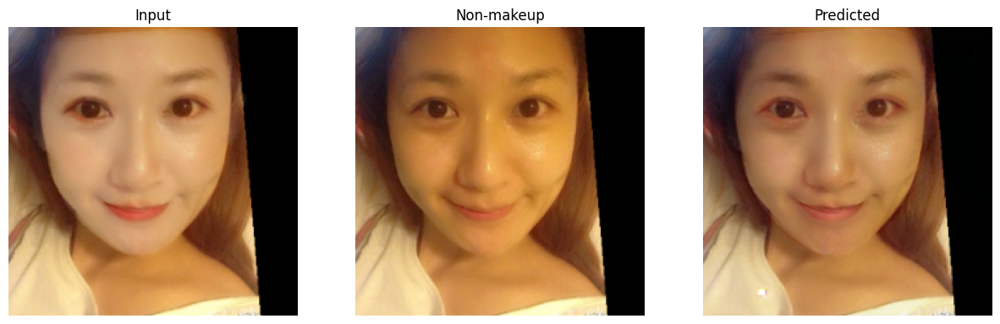

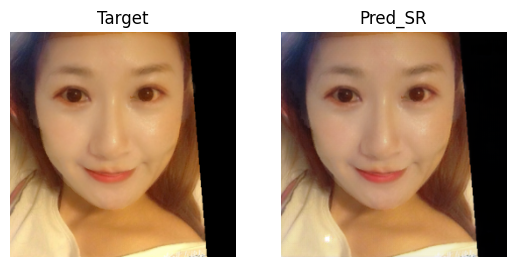

epoch: 114   loss: 0.0005763398366980255
-------- psnr_non:  26.199577 psnr_sr:  32.82285    ----- epoch:  114   count:  8


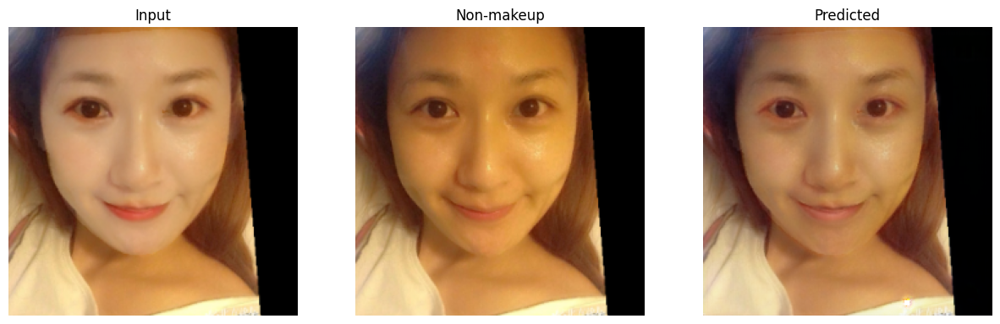

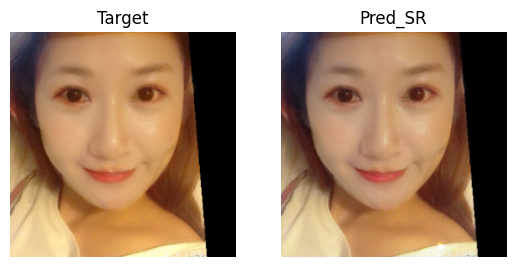

epoch: 115   loss: 0.0006031725788488984
-------- psnr_non:  26.269451 psnr_sr:  32.833714    ----- epoch:  115   count:  8


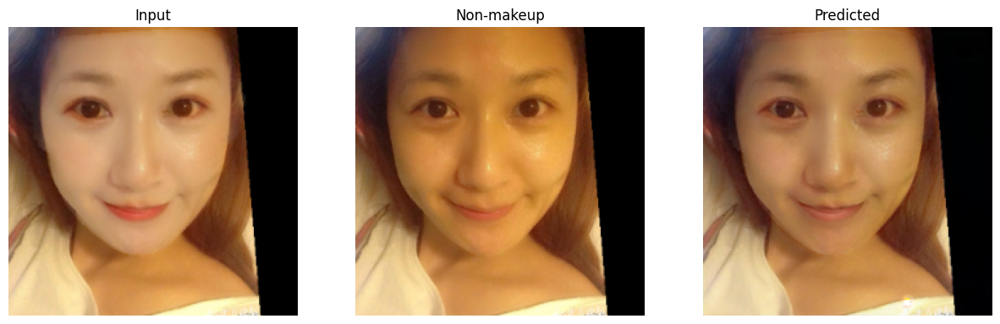

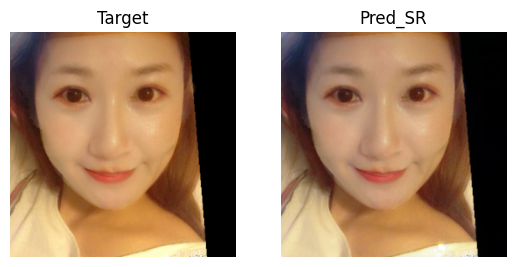

epoch: 116   loss: 0.0006745446589775383
-------- psnr_non:  26.021572 psnr_sr:  32.21208    ----- epoch:  116   count:  8
epoch: 117   loss: 0.000652064336463809
-------- psnr_non:  26.136446 psnr_sr:  32.438515    ----- epoch:  117   count:  8
epoch: 118   loss: 0.0005953406216576695
-------- psnr_non:  25.99402 psnr_sr:  32.472603    ----- epoch:  118   count:  8
epoch: 119   loss: 0.0005909232422709465
-------- psnr_non:  26.148233 psnr_sr:  32.701553    ----- epoch:  119   count:  8
epoch: 120   loss: 0.0006455398979596794
-------- psnr_non:  26.153496 psnr_sr:  32.393414    ----- epoch:  120   count:  8
epoch: 121   loss: 0.000598452053964138
-------- psnr_non:  26.027227 psnr_sr:  32.697533    ----- epoch:  121   count:  8
epoch: 122   loss: 0.0006481058080680668
-------- psnr_non:  25.979403 psnr_sr:  31.98998    ----- epoch:  122   count:  8
epoch: 123   loss: 0.0005905345315113664
-------- psnr_non:  26.1605 psnr_sr:  32.65285    ----- epoch:  123   count:  8
epoch: 124   los

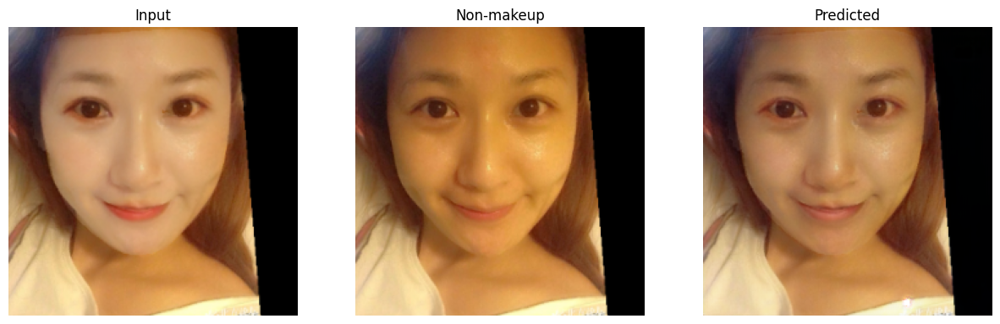

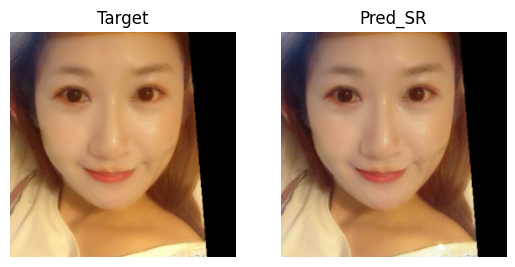

epoch: 137   loss: 0.0004148197767790407
-------- psnr_non:  26.303574 psnr_sr:  33.026012    ----- epoch:  137   count:  8


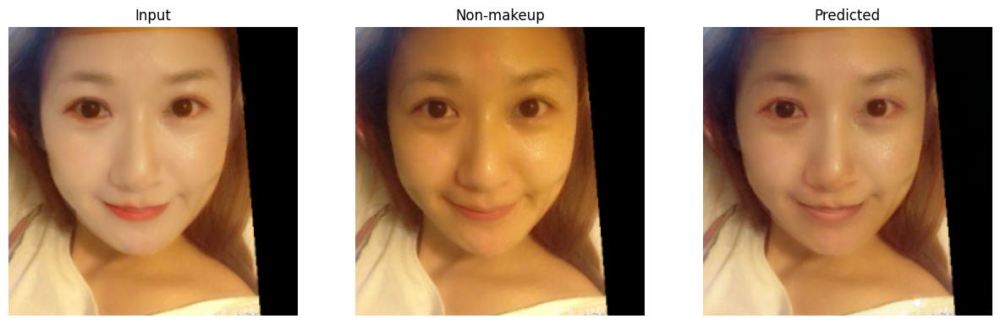

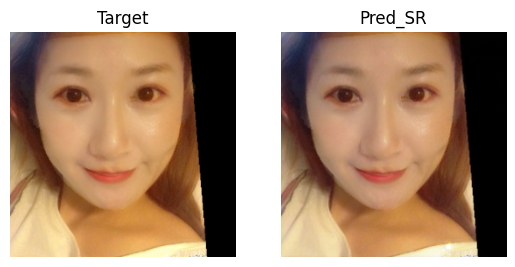

epoch: 138   loss: 0.00040499685565009713
-------- psnr_non:  26.066591 psnr_sr:  32.60902    ----- epoch:  138   count:  8
epoch: 139   loss: 0.00042924730223603547
-------- psnr_non:  26.1243 psnr_sr:  32.788773    ----- epoch:  139   count:  8
epoch: 140   loss: 0.00040515584987588227
-------- psnr_non:  26.146576 psnr_sr:  33.003784    ----- epoch:  140   count:  8
epoch: 141   loss: 0.0003812330833170563
-------- psnr_non:  26.10539 psnr_sr:  32.7209    ----- epoch:  141   count:  8
epoch: 142   loss: 0.0004020503838546574
-------- psnr_non:  26.246788 psnr_sr:  33.021683    ----- epoch:  142   count:  8
epoch: 143   loss: 0.0003766980371437967
-------- psnr_non:  26.217794 psnr_sr:  32.96907    ----- epoch:  143   count:  8
epoch: 144   loss: 0.0003880113363265991
-------- psnr_non:  26.213282 psnr_sr:  33.06172    ----- epoch:  144   count:  8
epoch: 145   loss: 0.00042684131767600775
-------- psnr_non:  25.891975 psnr_sr:  32.327477    ----- epoch:  145   count:  8
epoch: 146  

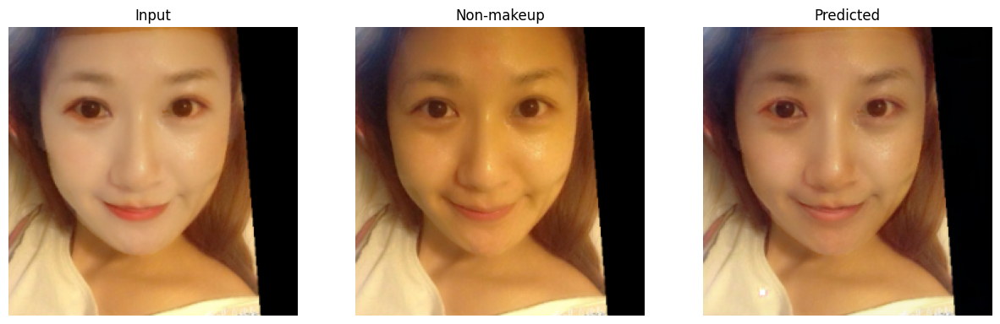

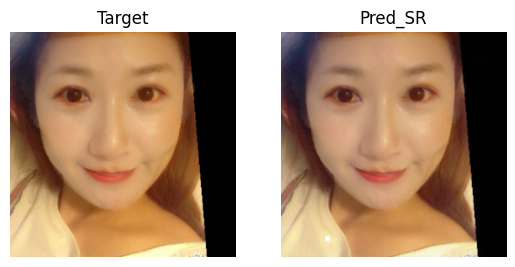

epoch: 170   loss: 0.00028899862081743777
-------- psnr_non:  26.149208 psnr_sr:  32.922085    ----- epoch:  170   count:  8
epoch: 171   loss: 0.00027240157942287624
-------- psnr_non:  25.785439 psnr_sr:  32.139473    ----- epoch:  171   count:  8
epoch: 172   loss: 0.00038867141120135784
-------- psnr_non:  26.078428 psnr_sr:  32.6361    ----- epoch:  172   count:  8
epoch: 173   loss: 0.0003094505809713155
-------- psnr_non:  26.090641 psnr_sr:  32.8095    ----- epoch:  173   count:  8
epoch: 174   loss: 0.0002803305396810174
-------- psnr_non:  26.14472 psnr_sr:  32.861343    ----- epoch:  174   count:  8
epoch: 175   loss: 0.0002579541760496795
-------- psnr_non:  26.22708 psnr_sr:  33.00344    ----- epoch:  175   count:  8
epoch: 176   loss: 0.00025119201745837927
-------- psnr_non:  26.173016 psnr_sr:  32.88549    ----- epoch:  176   count:  8
epoch: 177   loss: 0.00025510796695016325
-------- psnr_non:  26.228218 psnr_sr:  32.80811    ----- epoch:  177   count:  8
epoch: 178  

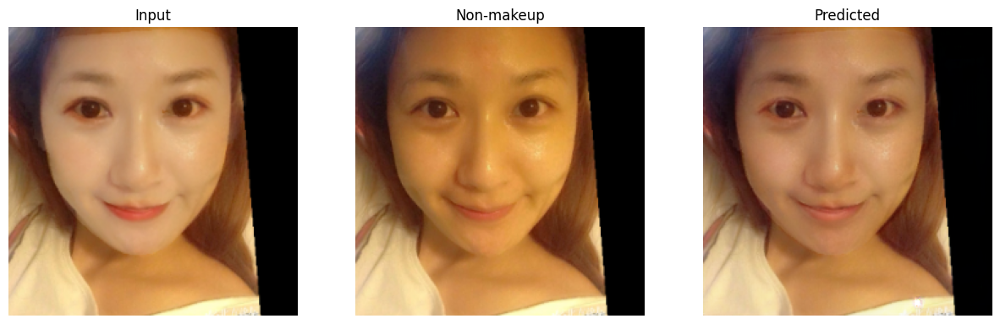

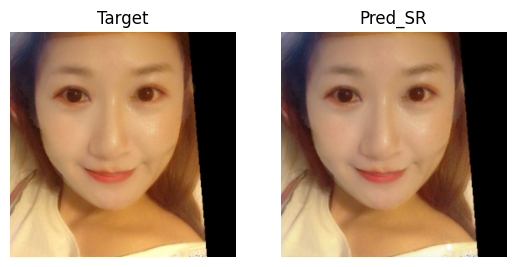

epoch: 189   loss: 0.00021391635527834296
-------- psnr_non:  26.156618 psnr_sr:  33.172733    ----- epoch:  189   count:  8
epoch: 190   loss: 0.00033104862086474895
-------- psnr_non:  26.068886 psnr_sr:  32.92996    ----- epoch:  190   count:  8
epoch: 191   loss: 0.00025563378585502505
-------- psnr_non:  26.270954 psnr_sr:  33.177288    ----- epoch:  191   count:  8


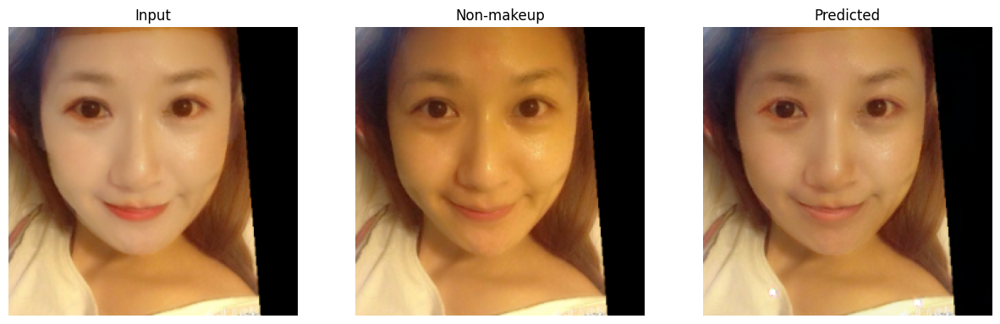

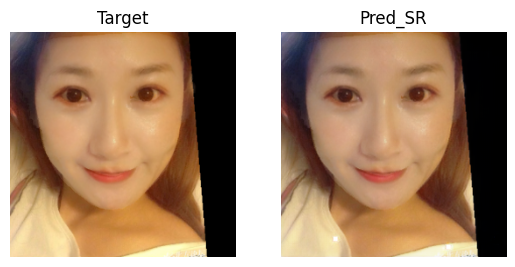

epoch: 192   loss: 0.00024526246124878526
-------- psnr_non:  26.12009 psnr_sr:  32.755424    ----- epoch:  192   count:  8
epoch: 193   loss: 0.0002317114849574864
-------- psnr_non:  26.247566 psnr_sr:  32.855335    ----- epoch:  193   count:  8
epoch: 194   loss: 0.00020170814241282642
-------- psnr_non:  26.250948 psnr_sr:  32.96263    ----- epoch:  194   count:  8
epoch: 195   loss: 0.00020518474048003554
-------- psnr_non:  26.205387 psnr_sr:  32.947575    ----- epoch:  195   count:  8
epoch: 196   loss: 0.00020309636602178216
-------- psnr_non:  26.222609 psnr_sr:  32.994507    ----- epoch:  196   count:  8
epoch: 197   loss: 0.00020371311984490603
-------- psnr_non:  26.26443 psnr_sr:  33.25966    ----- epoch:  197   count:  8


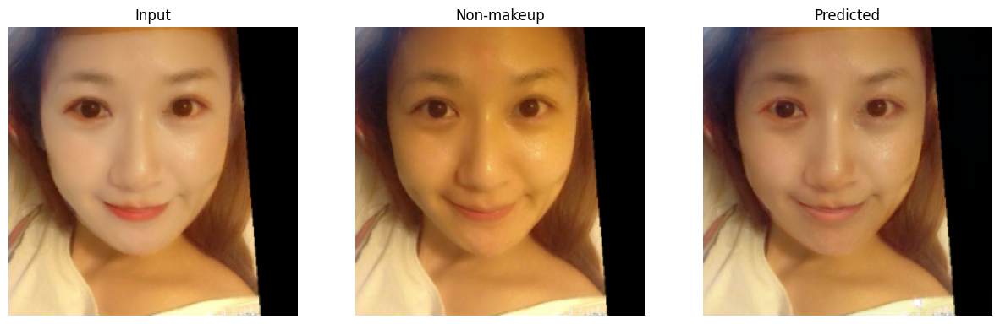

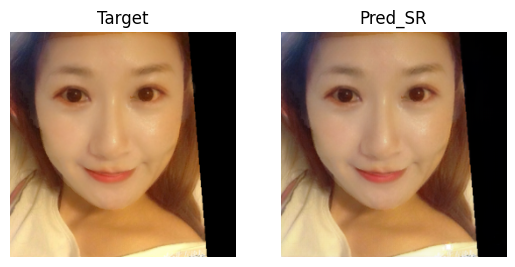

epoch: 198   loss: 0.00018386586452834308
-------- psnr_non:  26.261297 psnr_sr:  33.15346    ----- epoch:  198   count:  8
epoch: 199   loss: 0.00018356395594310015
-------- psnr_non:  26.245827 psnr_sr:  33.198032    ----- epoch:  199   count:  8
epoch: 200   loss: 0.00018020269635599107
-------- psnr_non:  26.21103 psnr_sr:  33.20645    ----- epoch:  200   count:  8
epoch: 201   loss: 0.00018085459305439144
-------- psnr_non:  26.207352 psnr_sr:  33.132206    ----- epoch:  201   count:  8
epoch: 202   loss: 0.0001938061323016882
-------- psnr_non:  26.138653 psnr_sr:  32.743988    ----- epoch:  202   count:  8
epoch: 203   loss: 0.00021025763999205083
-------- psnr_non:  26.123827 psnr_sr:  33.171135    ----- epoch:  203   count:  8
epoch: 204   loss: 0.0001999412343138829
-------- psnr_non:  26.204197 psnr_sr:  33.183277    ----- epoch:  204   count:  8
epoch: 205   loss: 0.00019508739933371544
-------- psnr_non:  26.16987 psnr_sr:  32.923954    ----- epoch:  205   count:  8
epoch:

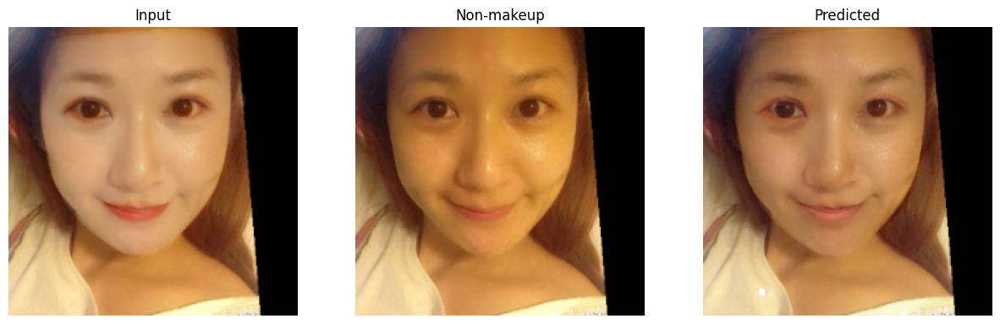

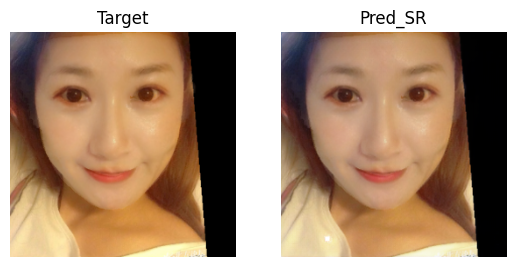

epoch: 210   loss: 0.00017534955986775458
-------- psnr_non:  26.29736 psnr_sr:  33.268803    ----- epoch:  210   count:  8


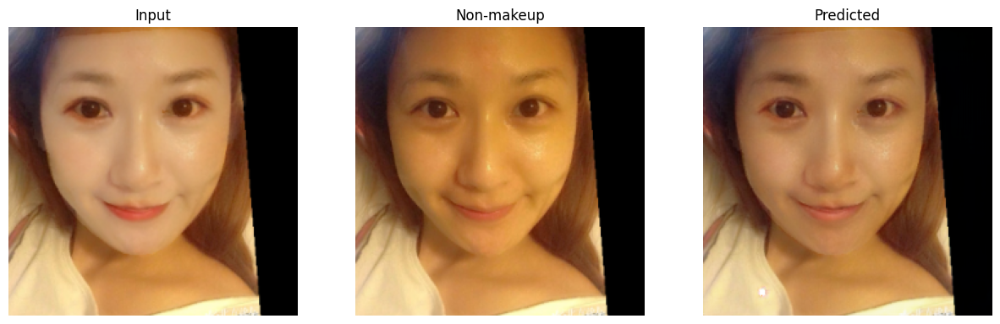

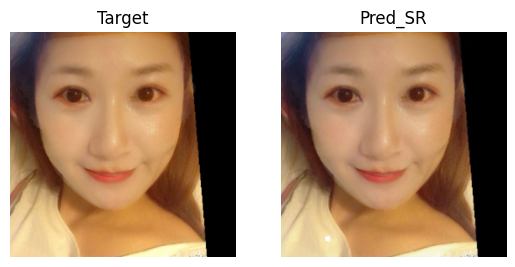

epoch: 211   loss: 0.00018212861323263496
-------- psnr_non:  26.173443 psnr_sr:  33.25263    ----- epoch:  211   count:  8
epoch: 212   loss: 0.0001793963892851025
-------- psnr_non:  26.264194 psnr_sr:  33.158504    ----- epoch:  212   count:  8
epoch: 213   loss: 0.0001677858381299302
-------- psnr_non:  26.26639 psnr_sr:  33.258987    ----- epoch:  213   count:  8
epoch: 214   loss: 0.00016340978618245572
-------- psnr_non:  26.215548 psnr_sr:  33.24857    ----- epoch:  214   count:  8
epoch: 215   loss: 0.00016628376033622772
-------- psnr_non:  26.18126 psnr_sr:  33.10872    ----- epoch:  215   count:  8
epoch: 216   loss: 0.00019212570623494685
-------- psnr_non:  26.152407 psnr_sr:  32.96413    ----- epoch:  216   count:  8
epoch: 217   loss: 0.000185376891749911
-------- psnr_non:  26.23243 psnr_sr:  33.35311    ----- epoch:  217   count:  8


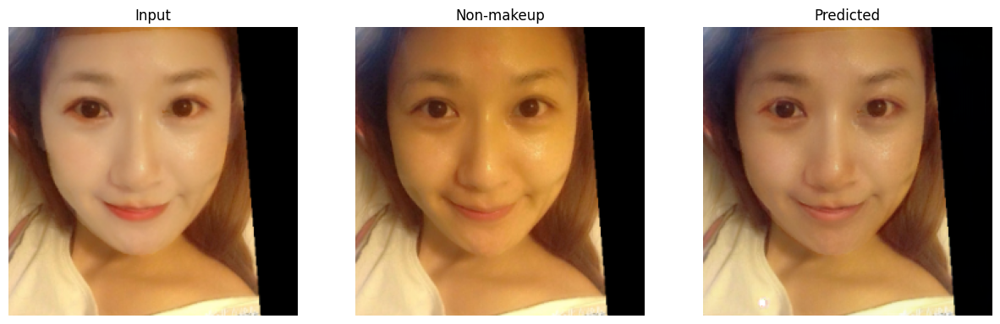

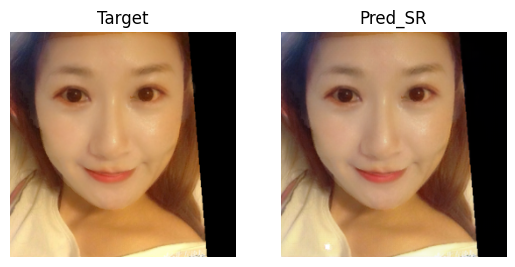

epoch: 218   loss: 0.00016610600869171321
-------- psnr_non:  26.2331 psnr_sr:  33.21498    ----- epoch:  218   count:  8
epoch: 219   loss: 0.0001551767491037026
-------- psnr_non:  26.28204 psnr_sr:  33.24991    ----- epoch:  219   count:  8
epoch: 220   loss: 0.00015036590048111975
-------- psnr_non:  26.283524 psnr_sr:  33.390797    ----- epoch:  220   count:  8


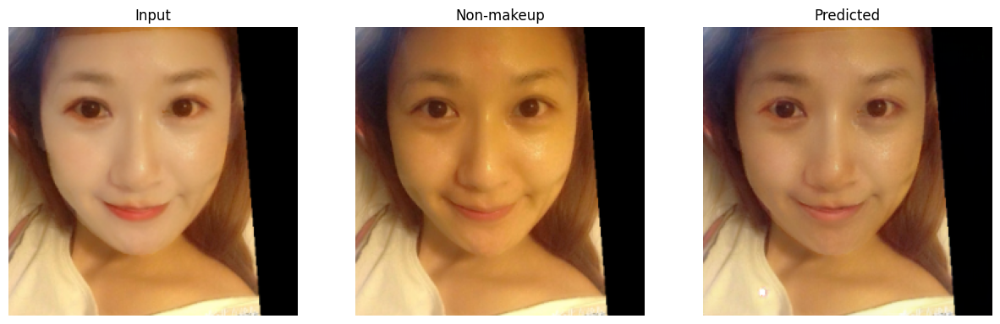

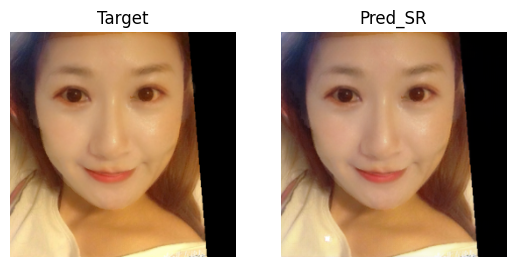

epoch: 221   loss: 0.00015402892313431948
-------- psnr_non:  26.227444 psnr_sr:  33.184284    ----- epoch:  221   count:  8
epoch: 222   loss: 0.0001506629923824221
-------- psnr_non:  26.17538 psnr_sr:  33.227875    ----- epoch:  222   count:  8
epoch: 223   loss: 0.00015505844203289598
-------- psnr_non:  26.23354 psnr_sr:  33.3432    ----- epoch:  223   count:  8
epoch: 224   loss: 0.0001485828252043575
-------- psnr_non:  26.207258 psnr_sr:  33.36847    ----- epoch:  224   count:  8
epoch: 225   loss: 0.00014489481691271067
-------- psnr_non:  26.21408 psnr_sr:  33.2604    ----- epoch:  225   count:  8
epoch: 226   loss: 0.0001390737743349746
-------- psnr_non:  26.241888 psnr_sr:  33.275414    ----- epoch:  226   count:  8
epoch: 227   loss: 0.00014049552555661649
-------- psnr_non:  26.18304 psnr_sr:  33.085434    ----- epoch:  227   count:  8
epoch: 228   loss: 0.0001461358042433858
-------- psnr_non:  26.279694 psnr_sr:  33.360176    ----- epoch:  228   count:  8
epoch: 229   

epoch: 288   loss: 7.90672202128917e-05
-------- psnr_non:  26.15653 psnr_sr:  33.300697    ----- epoch:  288   count:  8
epoch: 289   loss: 7.871348498156294e-05
-------- psnr_non:  26.166294 psnr_sr:  33.35298    ----- epoch:  289   count:  8
epoch: 290   loss: 7.81438357080333e-05
-------- psnr_non:  26.168304 psnr_sr:  33.334106    ----- epoch:  290   count:  8
epoch: 291   loss: 7.760991138638929e-05
-------- psnr_non:  26.161156 psnr_sr:  33.350697    ----- epoch:  291   count:  8
epoch: 292   loss: 7.709423516644165e-05
-------- psnr_non:  26.161875 psnr_sr:  33.35213    ----- epoch:  292   count:  8
epoch: 293   loss: 7.686408935114741e-05
-------- psnr_non:  26.164658 psnr_sr:  33.330715    ----- epoch:  293   count:  8
epoch: 294   loss: 7.668278703931719e-05
-------- psnr_non:  26.167685 psnr_sr:  33.329845    ----- epoch:  294   count:  8
epoch: 295   loss: 7.607482257299125e-05
-------- psnr_non:  26.162355 psnr_sr:  33.31662    ----- epoch:  295   count:  8
epoch: 296   l

In [22]:
a = time()
fit(res34Unet, train_dataset, EPOCHS, val_dataset)
print(time()-a)